In [1]:
%%script False
# installs for new libraries
pip install phik
pip install pandas-profiling
pip install missingno
pip install plotly

Couldn't find program: 'False'


In [2]:
import pandas as pd
from datetime import datetime, timedelta
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
import missingno as msgn
from phik.report import plot_correlation_matrix
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
import pylab as py
import plotly.express as px
from collections import Counter
from sklearn.model_selection import train_test_split

from sklearn.model_selection import cross_val_score
from sklearn.feature_selection import f_classif
from sklearn.model_selection import StratifiedKFold

from sklearn.preprocessing import PowerTransformer

from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV

from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.utils.class_weight import compute_class_weight
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import shap

from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import mutual_info_classif
from sklearn.model_selection import cross_validate

from sklearn.metrics import roc_curve
from sklearn.metrics import precision_recall_curve
from matplotlib import pyplot
from numpy import argmax
from sklearn.metrics import f1_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from sklearn.metrics import f1_score

In [3]:
df = pd.read_excel(r'CARGO_FOTP_DATASET.xlsx')
df.head(3)

,FLT_NO,ACT_CUS_FLE,FLEET,FLEET_FAM,FLEET_FAM_GRP,FLEET_BODY_TYP,FLT_TYP,LEG_DEP_AP,LEG_DEP_GMT_DT,LEG_DEP_GMT_TM,...,DELAY2_SUB_CODE,DELAY3_SUB_CODE,DELAY4_SUB_CODE,DELAY_ROOT_ARR_AP,DELAY_ROOT_DEP_AP,DELAY1_DURATION,DELAY2_DURATION,DELAY3_DURATION,DELAY4_DURATION,TOT_DELAY_DURATION
0,FL7064,FL-45X,TX750-30,TX750,TX750,B1,TYP1,IST,20210509,1205,...,NaN,NaN,NaN,?,?,0,0,0,0,0
1,FL7064,FL-45X,TX750-30,TX750,TX750,B1,TYP1,IST,20210512,1526,...,NaN,NaN,NaN,?,?,0,0,0,0,0
2,FL7064,FL-45X,TX750-30,TX750,TX750,B1,TYP1,IST,20210516,1209,...,NaN,NaN,NaN,?,?,0,0,0,0,0


In [4]:
df.shape

(99546, 28)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99546 entries, 0 to 99545
Data columns (total 28 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   FLT_NO               99546 non-null  object
 1   ACT_CUS_FLE          99546 non-null  object
 2   FLEET                99546 non-null  object
 3   FLEET_FAM            99546 non-null  object
 4   FLEET_FAM_GRP        99546 non-null  object
 5   FLEET_BODY_TYP       99546 non-null  object
 6   FLT_TYP              99546 non-null  object
 7   LEG_DEP_AP           99546 non-null  object
 8   LEG_DEP_GMT_DT       99546 non-null  int64 
 9   LEG_DEP_GMT_TM       99546 non-null  int64 
 10  LEG_DEP_CNTRY_COD    99512 non-null  object
 11  LEG_DEP_RGN_COD      95771 non-null  object
 12  LEG_ARR_AP           99546 non-null  object
 13  LEG_ARR_GMT_DT       99546 non-null  int64 
 14  LEG_ARR_GMT_TM       99546 non-null  int64 
 15  LEG_ARR_CNTRY_COD    99512 non-null  object
 16  LEG_

In [6]:
df.describe()

,LEG_DEP_GMT_DT,LEG_DEP_GMT_TM,LEG_ARR_GMT_DT,LEG_ARR_GMT_TM,DELAY1_DURATION,DELAY2_DURATION,DELAY3_DURATION,DELAY4_DURATION,TOT_DELAY_DURATION
count,9.954600e+04,99546.000000,9.954600e+04,99546.000000,99546.000000,99546.000000,99546.000000,99546.000000,99546.000000
mean,2.019249e+07,1201.375203,2.019230e+07,1208.110803,112.058486,12.377192,2.249915,0.353264,127.038856
std,1.289824e+04,668.607877,6.528663e+04,666.799934,277.712802,67.957361,24.556694,8.632271,297.532552
min,2.017010e+07,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2.018083e+07,618.000000,2.018083e+07,646.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2.019112e+07,1235.000000,2.019112e+07,1226.000000,14.000000,0.000000,0.000000,0.000000,20.000000
75%,2.020093e+07,1757.000000,2.020093e+07,1757.000000,94.000000,7.000000,0.000000,0.000000,116.000000
max,2.021063e+07,2359.000000,2.021070e+07,2359.000000,7596.000000,5362.000000,2880.000000,1159.000000,7596.000000


In [7]:
%%script False
profile = ProfileReport(df, title="Pandas Profiling Report", explorative=True)
profile

Couldn't find program: 'False'


<AxesSubplot:>

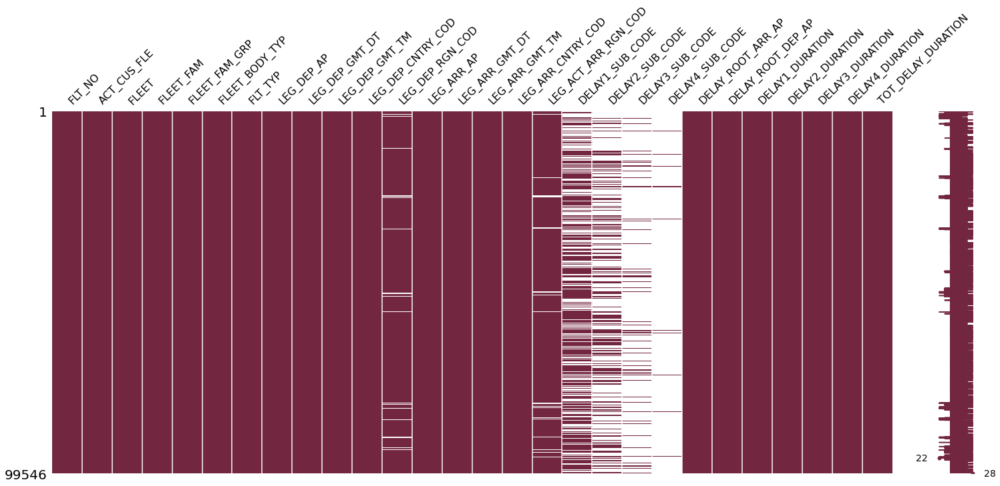

In [8]:
# missing values
msgn.matrix(df, color=(0.45, 0.15, 0.25))

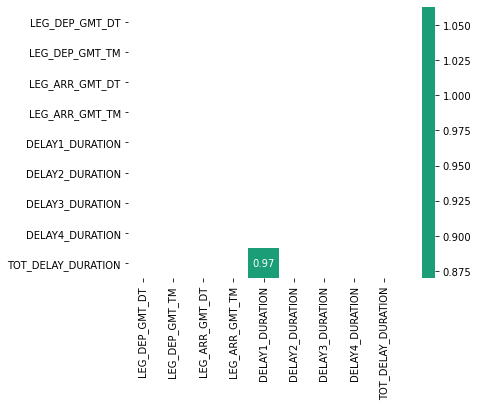

In [9]:
# correlation matrix
matrix = df.corr().abs()

# Create a mask
mask = np.triu(np.ones_like(matrix, dtype=bool))

# Create a custom diverging palette
cmap = sns.diverging_palette(250, 15, s=75, l=40, n=9, center="light", as_cmap=True)
plt.figure(figsize=(8, 5))
sns.heatmap(matrix[matrix>0.5], mask=mask, center=0, annot=True, fmt='.2f', square=True, cmap='Dark2_r')

plt.show();

interval columns not set, guessing: ['LEG_DEP_GMT_DT', 'LEG_DEP_GMT_TM', 'LEG_ARR_GMT_DT', 'LEG_ARR_GMT_TM', 'DELAY1_DURATION', 'DELAY2_DURATION', 'DELAY3_DURATION', 'DELAY4_DURATION', 'TOT_DELAY_DURATION']


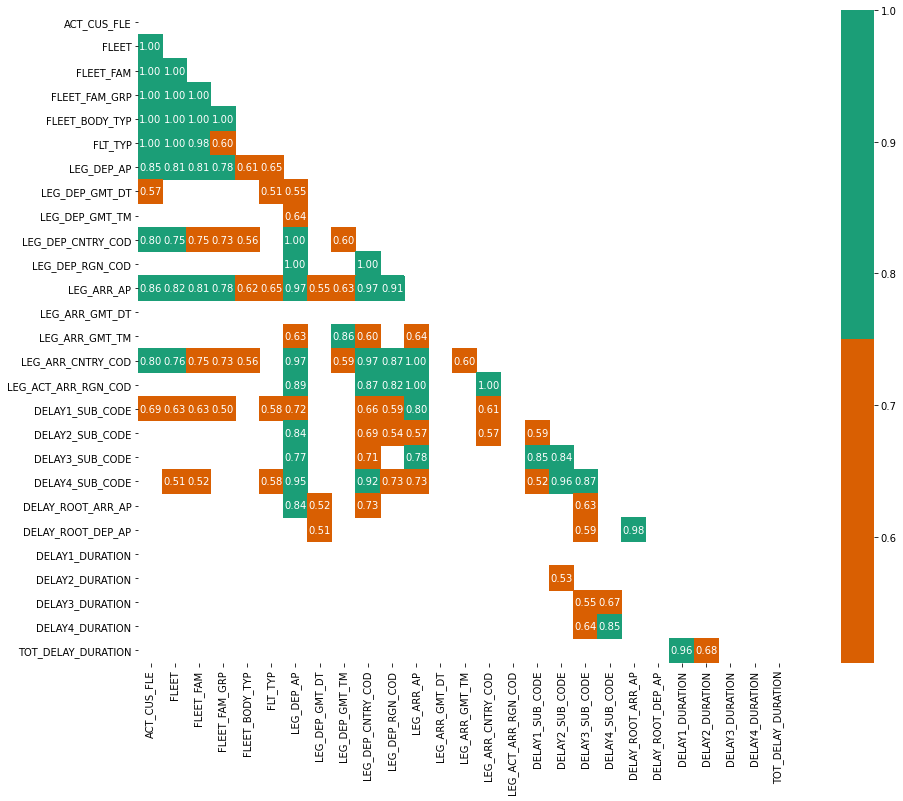

In [10]:
# phi correlation
# source: https://en.wikipedia.org/wiki/Phi_coefficient

phik_overview = df.drop('FLT_NO', axis=1).phik_matrix()

matrix = phik_overview.abs()

# Create a mask
mask = np.triu(np.ones_like(matrix, dtype=bool))

# Create a custom diverging palette
cmap = sns.diverging_palette(250, 15, s=75, l=40, n=9, center="light", as_cmap=True)
plt.figure(figsize=(18, 12))
sns.heatmap(matrix[matrix>0.5], mask=mask, center=0, annot=True, fmt='.2f', square=True, cmap='Dark2_r')

plt.show();

In [11]:
df.drop_duplicates().shape

(99546, 28)

In [12]:
df.head(2)

,FLT_NO,ACT_CUS_FLE,FLEET,FLEET_FAM,FLEET_FAM_GRP,FLEET_BODY_TYP,FLT_TYP,LEG_DEP_AP,LEG_DEP_GMT_DT,LEG_DEP_GMT_TM,...,DELAY2_SUB_CODE,DELAY3_SUB_CODE,DELAY4_SUB_CODE,DELAY_ROOT_ARR_AP,DELAY_ROOT_DEP_AP,DELAY1_DURATION,DELAY2_DURATION,DELAY3_DURATION,DELAY4_DURATION,TOT_DELAY_DURATION
0,FL7064,FL-45X,TX750-30,TX750,TX750,B1,TYP1,IST,20210509,1205,...,NaN,NaN,NaN,?,?,0,0,0,0,0
1,FL7064,FL-45X,TX750-30,TX750,TX750,B1,TYP1,IST,20210512,1526,...,NaN,NaN,NaN,?,?,0,0,0,0,0


## feature engineering

#### helper functions

In [13]:
def convert_date(x):
    if x != 0:
        return datetime.strptime(str(int(x)) , '%Y%m%d').strftime('%Y-%m-%d')
    else:
        return x
    
convert_hours = lambda x: datetime(1900, 1, 1, int(x)//100, int(x)%100)
find_hour_difference = lambda x,y : (convert_hours(x)-convert_hours(y)).total_seconds()/60 if not pd.isna(y) else np.nan
convert_to_timedelta = lambda x: timedelta(hours=int(x)//60, minutes=int(x)%60)
convert_time_to_interval = lambda x: 2*x.hour + (x.minute>30)

In [14]:
df['LEG_DEP_GMT_DT'] = df['LEG_DEP_GMT_DT'].apply(convert_date)
df['LEG_ARR_GMT_DT'] = df['LEG_ARR_GMT_DT'].apply(convert_date)
df['flight_duration_day'] = (pd.to_datetime(df['LEG_ARR_GMT_DT']) - pd.to_datetime(df['LEG_DEP_GMT_DT'])).apply(lambda x: x.days)
df['flight_duration_min'] = df[['LEG_ARR_GMT_TM', 'LEG_DEP_GMT_TM']].apply(lambda x: find_hour_difference(*x), axis=1)
df['flight_duration'] = df['flight_duration_min'] + df['flight_duration_day']*1440
df['arr_month'] = pd.to_datetime(df['LEG_ARR_GMT_DT']).dt.month
df['arr_weekday'] = pd.to_datetime(df['LEG_ARR_GMT_DT']).dt.weekday
df['arr_day'] = pd.to_datetime(df['LEG_ARR_GMT_DT']).dt.day
df['expected_arrival_interval'] = df['LEG_ARR_GMT_TM'].apply(convert_hours).apply(convert_time_to_interval)
df['expected_departure_interval'] = df['LEG_DEP_GMT_TM'].apply(convert_hours).apply(convert_time_to_interval)

In [15]:
df['flight_duration'].sort_values()

81585   -25756744.0
91747       -1239.0
81526          -5.0
10579          -2.0
2470            4.0
            ...    
49799         920.0
49796         922.0
49805         929.0
48810         935.0
48808         936.0
Name: flight_duration, Length: 99546, dtype: float64

In [16]:
# a flight that lasted 4 mins, a potential outlier
df.loc[2470]

FLT_NO                             FL7157
ACT_CUS_FLE                        FL-87Z
FLEET                           TW650-30Z
FLEET_FAM                           TW650
FLEET_FAM_GRP                       TW650
FLEET_BODY_TYP                         B1
FLT_TYP                              TYP1
LEG_DEP_AP                            IST
LEG_DEP_GMT_DT                 2020-07-13
LEG_DEP_GMT_TM                       1411
LEG_DEP_CNTRY_COD                      TR
LEG_DEP_RGN_COD                        DO
LEG_ARR_AP                            IST
LEG_ARR_GMT_DT                 2020-07-13
LEG_ARR_GMT_TM                       1415
LEG_ARR_CNTRY_COD                      TR
LEG_ACT_ARR_RGN_COD                    DO
DELAY1_SUB_CODE                       62D
DELAY2_SUB_CODE                       NaN
DELAY3_SUB_CODE                       NaN
DELAY4_SUB_CODE                       NaN
DELAY_ROOT_ARR_AP                       ?
DELAY_ROOT_DEP_AP                       ?
DELAY1_DURATION                   

In [17]:
df[df['LEG_DEP_AP'] == df['LEG_ARR_AP']]

,FLT_NO,ACT_CUS_FLE,FLEET,FLEET_FAM,FLEET_FAM_GRP,FLEET_BODY_TYP,FLT_TYP,LEG_DEP_AP,LEG_DEP_GMT_DT,LEG_DEP_GMT_TM,...,DELAY4_DURATION,TOT_DELAY_DURATION,flight_duration_day,flight_duration_min,flight_duration,arr_month,arr_weekday,arr_day,expected_arrival_interval,expected_departure_interval
265,FL7106,FL-87Z,TW650-30Z,TW650,TW650,B1,TYP1,HKG,2020-09-28,1441,...,0,0,0,40.0,40.0,9,0,28,30,29
297,FL7107,FL-45X,TX750-30,TX750,TX750,B1,TYP1,IST,2021-04-13,400,...,0,5,0,10.0,10.0,4,1,13,8,8
313,FL7107,FL-45X,TX750-30,TX750,TX750,B1,TYP1,JNB,2021-06-09,1606,...,0,21,0,56.0,56.0,6,2,9,34,32
363,FL7107,FL-45T,TX750-30,TX750,TX750,B1,TYP1,IST,2021-04-18,1350,...,0,120,0,32.0,32.0,4,6,18,28,27
937,FL7121,FL-45T,TX750-30,TX750,TX750,B1,TYP1,IST,2020-08-18,245,...,0,50,0,30.0,30.0,8,1,18,6,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
98402,FL7842,FL-4SX,TX750-20K,TX750,TX750,B1,TYP2,ALA,2019-04-13,459,...,0,54,0,31.0,31.0,4,5,13,10,9
98826,FL7844,FL-4RK,TX750-20K,TX750,TX750,B1,TYP2,ALA,2018-11-28,645,...,0,160,0,105.0,105.0,11,2,28,16,13
98962,FL7844,FL-4SX,TX750-20K,TX750,TX750,B1,TYP2,HKG,2019-09-03,2028,...,0,23,1,-1193.0,247.0,9,2,4,1,40
99419,FL7846,FL-4SX,TX750-20K,TX750,TX750,B1,TYP2,HKG,2021-03-23,313,...,0,8,0,10.0,10.0,3,1,23,6,6


In [18]:
df['TOT_DELAY_DURATION']

0          0
1          0
2          0
3          0
4          0
        ... 
99541    119
99542     56
99543     20
99544    221
99545     45
Name: TOT_DELAY_DURATION, Length: 99546, dtype: int64

In [19]:
df['FLEET_BODY_TYP'].value_counts()

B1    99520
B2       26
Name: FLEET_BODY_TYP, dtype: int64

In [20]:
df['FLEET'].value_counts()

TX750-20K     48647
TW600-20X     16459
TX650-40      11557
TW650-30Z      8896
TW510-40K      6102
TW510-40KX     3285
TX750-30       2064
TW510-40X      1568
TX500-60K       862
TW800-9          53
TX750-20         16
TX750-34         11
TW500-80          8
TX702-23          7
TW500-90Z         4
TX702-20          4
TX702-27          3
Name: FLEET, dtype: int64

In [21]:
# we can see a correlation between 'FLEET' and 'ACT_CUS_FLE' clearly
for i in df['FLEET'].unique():
    print('Fleet: ', i)
    print('Fleet types: ')
    print(df[df['FLEET']==i]['ACT_CUS_FLE'].value_counts())
    print('_-----------------------')

Fleet:  TX750-30
Fleet types: 
FL-45T    1199
FL-45X     622
FL-443     218
FL-45Y      25
Name: ACT_CUS_FLE, dtype: int64
_-----------------------
Fleet:  TW650-30Z
Fleet types: 
FL-87Z    7117
FL-87N    1769
FL-87T      10
Name: ACT_CUS_FLE, dtype: int64
_-----------------------
Fleet:  TX650-40
Fleet types: 
XYT    11051
XYZ      506
Name: ACT_CUS_FLE, dtype: int64
_-----------------------
Fleet:  TX750-20K
Fleet types: 
FL-45S    44768
FL-4SX     2538
FL-4RK     1177
FL-45L      164
Name: ACT_CUS_FLE, dtype: int64
_-----------------------
Fleet:  TW600-20X
Fleet types: 
FL-87S    16459
Name: ACT_CUS_FLE, dtype: int64
_-----------------------
Fleet:  TX702-23
Fleet types: 
FL-441    7
Name: ACT_CUS_FLE, dtype: int64
_-----------------------
Fleet:  TX750-20
Fleet types: 
FL-442    16
Name: ACT_CUS_FLE, dtype: int64
_-----------------------
Fleet:  TX702-20
Fleet types: 
FL-44K    4
Name: ACT_CUS_FLE, dtype: int64
_-----------------------
Fleet:  TX702-27
Fleet types: 
XYA    3
Name:

In [22]:
df.head(2)

,FLT_NO,ACT_CUS_FLE,FLEET,FLEET_FAM,FLEET_FAM_GRP,FLEET_BODY_TYP,FLT_TYP,LEG_DEP_AP,LEG_DEP_GMT_DT,LEG_DEP_GMT_TM,...,DELAY4_DURATION,TOT_DELAY_DURATION,flight_duration_day,flight_duration_min,flight_duration,arr_month,arr_weekday,arr_day,expected_arrival_interval,expected_departure_interval
0,FL7064,FL-45X,TX750-30,TX750,TX750,B1,TYP1,IST,2021-05-09,1205,...,0,0,0,464.0,464.0,5,6,9,39,24
1,FL7064,FL-45X,TX750-30,TX750,TX750,B1,TYP1,IST,2021-05-12,1526,...,0,0,0,436.0,436.0,5,2,12,45,30


In [23]:
df.columns

Index(['FLT_NO', 'ACT_CUS_FLE', 'FLEET', 'FLEET_FAM', 'FLEET_FAM_GRP',
       'FLEET_BODY_TYP', 'FLT_TYP', 'LEG_DEP_AP', 'LEG_DEP_GMT_DT',
       'LEG_DEP_GMT_TM', 'LEG_DEP_CNTRY_COD', 'LEG_DEP_RGN_COD', 'LEG_ARR_AP',
       'LEG_ARR_GMT_DT', 'LEG_ARR_GMT_TM', 'LEG_ARR_CNTRY_COD',
       'LEG_ACT_ARR_RGN_COD', 'DELAY1_SUB_CODE', 'DELAY2_SUB_CODE',
       'DELAY3_SUB_CODE', 'DELAY4_SUB_CODE', 'DELAY_ROOT_ARR_AP',
       'DELAY_ROOT_DEP_AP', 'DELAY1_DURATION', 'DELAY2_DURATION',
       'DELAY3_DURATION', 'DELAY4_DURATION', 'TOT_DELAY_DURATION',
       'flight_duration_day', 'flight_duration_min', 'flight_duration',
       'arr_month', 'arr_weekday', 'arr_day', 'expected_arrival_interval',
       'expected_departure_interval'],
      dtype='object')

In [24]:
# labels
df['delayed'] = 0
df.loc[df['TOT_DELAY_DURATION']>0, 'delayed'] = 1

In [25]:
df['delayed'].value_counts()

1    63399
0    36147
Name: delayed, dtype: int64

In [26]:
delay_labels = list(df['DELAY1_SUB_CODE'].value_counts()[df['DELAY1_SUB_CODE'].value_counts()>100].index)

In [27]:
sum(df['DELAY1_SUB_CODE'].isna())

36147

In [28]:
df['DELAY1_SUB_CODE'].value_counts()

93Z    36277
89Z     6702
26C     2822
22E     1521
09C      944
       ...  
39B        1
83Y        1
17P        1
41O        1
26X        1
Name: DELAY1_SUB_CODE, Length: 353, dtype: int64

In [29]:
categorical_str = ['ACT_CUS_FLE', 'LEG_DEP_AP', 'LEG_ARR_AP']

categorical_int = ['arr_month', 'arr_weekday', 'arr_day', 'expected_arrival_interval','expected_departure_interval']

numerical = ['flight_duration']

label= ['delayed']

drop_cols = ['FLT_NO','TOT_DELAY_DURATION', 'FLT_TYP','LEG_DEP_GMT_DT', 'LEG_DEP_GMT_TM', 'LEG_ARR_GMT_DT',
             'LEG_ARR_GMT_TM', 'DELAY1_SUB_CODE', 'DELAY2_SUB_CODE', 'LEG_DEP_CNTRY_COD', 'LEG_DEP_RGN_COD',
             'DELAY3_SUB_CODE', 'DELAY4_SUB_CODE', 'DELAY_ROOT_ARR_AP', 'LEG_ARR_CNTRY_COD', 'LEG_ACT_ARR_RGN_COD',
             'DELAY1_DURATION', 'DELAY2_DURATION', 'DELAY3_DURATION', 'DELAY4_DURATION',
             'DELAY_ROOT_DEP_AP', 'DELAY1_DURATION', 'flight_duration_day', 'flight_duration_min',
            'FLEET_FAM', 'FLEET_FAM_GRP', 'FLEET_BODY_TYP', 'FLEET']

In [30]:
df = df[categorical_str+categorical_int+numerical+label]

In [31]:
df.columns

Index(['ACT_CUS_FLE', 'LEG_DEP_AP', 'LEG_ARR_AP', 'arr_month', 'arr_weekday',
       'arr_day', 'expected_arrival_interval', 'expected_departure_interval',
       'flight_duration', 'delayed'],
      dtype='object')

### arranging dataframe

In [32]:
# removing outliers
df = df[df['LEG_DEP_AP'] != df['LEG_ARR_AP']] # flight that have same arrival and departure point
df = df[df['flight_duration']>0] #  min flight duration?, max flight duration?

### drop duplicates

In [33]:
print(df.shape)
df.drop_duplicates(inplace=True)
print(df.shape)

(99203, 10)
(99200, 10)


### correlation

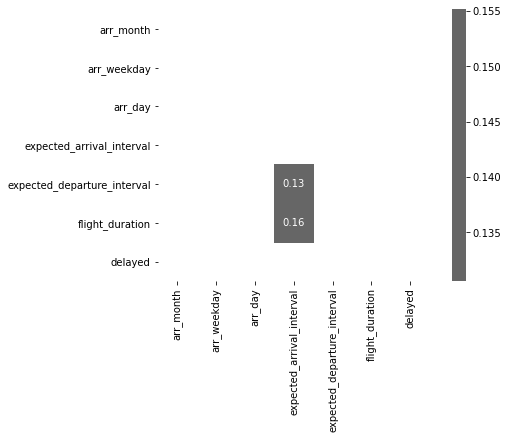

In [34]:
matrix = df.corr().abs()

# Create a mask
mask = np.triu(np.ones_like(matrix, dtype=bool))

# Create a custom diverging palette
cmap = sns.diverging_palette(250, 15, s=75, l=40, n=9, center="light", as_cmap=True)
plt.figure(figsize=(8,5))
sns.heatmap(matrix[matrix>0.1], mask=mask, center=0, annot=True, fmt='.2f', square=True, cmap='Accent')

plt.show();

### visualizations

In [35]:
df.columns

Index(['ACT_CUS_FLE', 'LEG_DEP_AP', 'LEG_ARR_AP', 'arr_month', 'arr_weekday',
       'arr_day', 'expected_arrival_interval', 'expected_departure_interval',
       'flight_duration', 'delayed'],
      dtype='object')

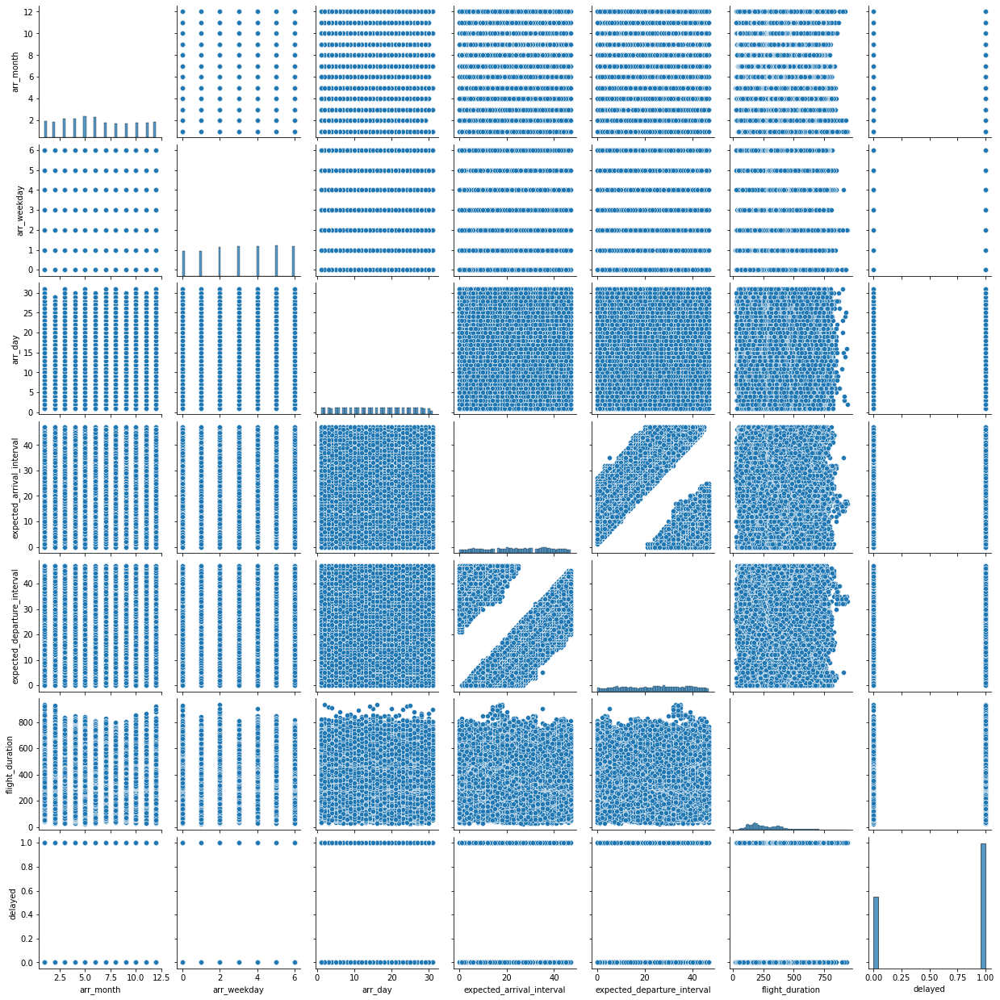

In [36]:
sns.pairplot(df)

## eda for numerical features

In [37]:
# distribution for flight duration

colors_blue = ["#132C33", "#264D58", '#17869E', '#51C4D3', '#B4DBE9']
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']

fig = px.histogram(df,x='flight_duration',color='delayed',template='plotly_white',
                  marginal='box',opacity=0.7,nbins=100,color_discrete_sequence=[colors_green[3],colors_blue[3]],
                  barmode='group',histfunc='count')
fig.add_vline(x=151, line_width=1, line_color=colors_dark[1],line_dash='dot',opacity=0.7)
fig.add_vline(x=301, line_width=1, line_color=colors_dark[1],line_dash='dot',opacity=0.7)
fig.add_vline(x=76, line_width=1, line_color=colors_dark[1],line_dash='dot',opacity=0.7)
fig.update_layout(
    font_family='monospace',
    title=dict(text='Flight Duration Distribution',x=0.53,y=0.95,
               font=dict(color=colors_dark[2],size=20)),
    xaxis_title_text='Flight Duration(min)',
    yaxis_title_text='Count',
    legend=dict(x=1,y=0.96,bordercolor=colors_dark[4],borderwidth=0,tracegroupgap=5),
    bargap=0.3,
)
fig.show()

In [38]:
# low flight durations?
# high durations look okay
df['flight_duration'].sort_values()

49743     23.0
43998     26.0
50463     27.0
94882     28.0
89668     28.0
         ...  
49799    920.0
49796    922.0
49805    929.0
48810    935.0
48808    936.0
Name: flight_duration, Length: 99200, dtype: float64

# comments

flight duration should be transformed to normal distribution

some flight durations are less than 0 and outlier, should be removed

### eda for categorical variables

<AxesSubplot:>

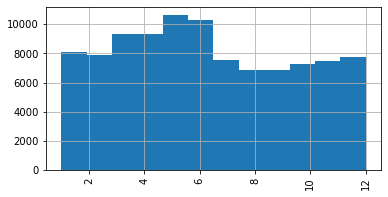

In [39]:
df['arr_month'].hist(bins=12, xrot=90, figsize=(6,3), )

In [40]:
fig = px.histogram(
    df['arr_month'], 
    nbins = len(df['arr_month'].unique()), # number of bins
    labels = {
        'value': 'Month', # x axis label in histogram is value 
        'count': 'Counts' # y axis label in histogram is count 
    },
    title = 'Month of arrival flights',
    marginal = 'violin', # for violin above the histogram
    color_discrete_sequence = ['green'], # color of the graph 
    width=600,
    height=400
)
fig.update_layout(
    xaxis = dict(showgrid = False, showline = True, linecolor = 'black' ),
    yaxis = dict( showgrid = False, showline = True, linecolor = 'black' ),
    plot_bgcolor = 'white',
    bargap = 0.2, # gaps between bars  
    showlegend = False, # for not displaying the legend 
    
)
fig.show()

In [41]:
fig = px.histogram(
    df['arr_weekday'], 
    nbins = len(df['arr_weekday'].unique()), # number of bins
    labels = {
        'value': 'Weekday', # x axis label in histogram is value 
        'count': 'Counts' # y axis label in histogram is count 
    },
    title = 'Weekday of arrival flights',
    marginal = 'violin', # for violin above the histogram
    color_discrete_sequence = ['green'], # color of the graph 
    category_orders=dict(day=["Sun", "Mon", "Tue", "Wen","Thu", "Fri", "Sat"]),
    width=600,
    height=400
)
fig.update_layout(
    xaxis = dict(showgrid = False, showline = True, linecolor = 'black' ),
    yaxis = dict( showgrid = False, showline = True, linecolor = 'black' ),
    plot_bgcolor = 'white',
    bargap = 0.2, # gaps between bars  
    showlegend = False, # for not displaying the legend 
    
)
fig.show()

In [42]:
fig = px.histogram(
    df['arr_day'], 
    nbins = len(df['arr_day'].unique()), # number of bins
    labels = {
        'value': 'Day', # x axis label in histogram is value 
        'count': 'Counts' # y axis label in histogram is count 
    },
    title = 'Day of arrival flights',
    marginal = 'violin', # for violin above the histogram
    color_discrete_sequence = ['green'], # color of the graph 
    width=600,
    height=400
)
fig.update_layout(
    xaxis = dict(showgrid = False, showline = True, linecolor = 'black' ),
    yaxis = dict( showgrid = False, showline = True, linecolor = 'black' ),
    plot_bgcolor = 'white',
    bargap = 0.2, # gaps between bars  
    showlegend = False, # for not displaying the legend 
    
)
fig.show()

In [43]:
fig = px.histogram(
    df['expected_arrival_interval'], 
    nbins = len(df['expected_arrival_interval'].unique()), # number of bins
    labels = {
        'value': 'Interval', # x axis label in histogram is value 
        'count': 'Counts' # y axis label in histogram is count 
    },
    title = 'Interval of arrival flights',
    marginal = 'violin', # for violin above the histogram
    color_discrete_sequence = ['green'], # color of the graph 
    width=600,
    height=400
)
fig.update_layout(
    xaxis = dict(showgrid = False, showline = True, linecolor = 'black' ),
    yaxis = dict( showgrid = False, showline = True, linecolor = 'black' ),
    plot_bgcolor = 'white',
    bargap = 0.2, # gaps between bars  
    showlegend = False, # for not displaying the legend 
    
)
fig.show()

In [44]:
fig = px.histogram(
    df['expected_departure_interval'], 
    nbins = len(df['expected_departure_interval'].unique()), # number of bins
    labels = {
        'value': 'Day', # x axis label in histogram is value 
        'count': 'Counts' # y axis label in histogram is count 
    },
    title = 'Interval of departure flights',
    marginal = 'violin', # for violin above the histogram
    color_discrete_sequence = ['green'], # color of the graph 
    width=600,
    height=400
)
fig.update_layout(
    xaxis = dict(showgrid = False, showline = True, linecolor = 'black' ),
    yaxis = dict( showgrid = False, showline = True, linecolor = 'black' ),
    plot_bgcolor = 'white',
    bargap = 0.2, # gaps between bars  
    showlegend = False, # for not displaying the legend 
    
)
fig.show()

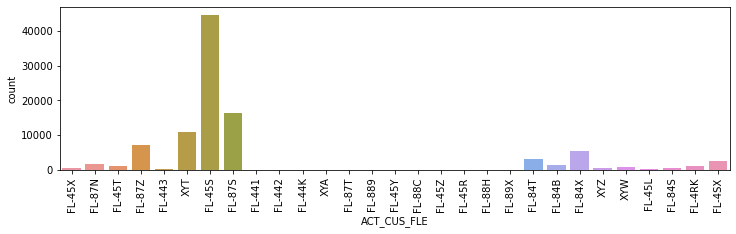

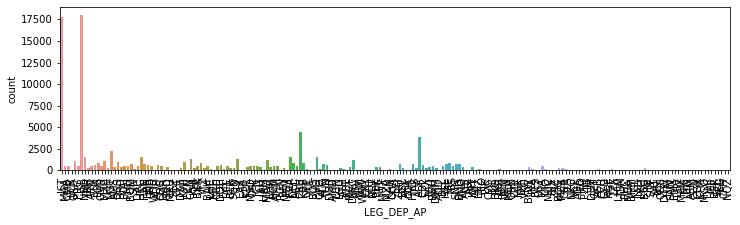

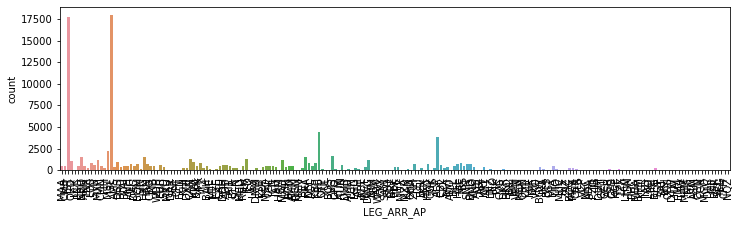

In [45]:
for i, col in enumerate(categorical_str):

    plt.figure(2*i, figsize=(12,3))
    ax = sns.countplot(x=col, data=df)
    ax.set_xticklabels(ax.get_xticklabels(),rotation = 90)

In [46]:
df.shape

(99200, 10)

In [47]:
df.isna().sum()

ACT_CUS_FLE                    0
LEG_DEP_AP                     0
LEG_ARR_AP                     0
arr_month                      0
arr_weekday                    0
arr_day                        0
expected_arrival_interval      0
expected_departure_interval    0
flight_duration                0
delayed                        0
dtype: int64

In [48]:
df.dropna(inplace=True)

### phi correlation

interval columns not set, guessing: ['arr_month', 'arr_weekday', 'arr_day', 'expected_arrival_interval', 'expected_departure_interval', 'flight_duration', 'delayed']


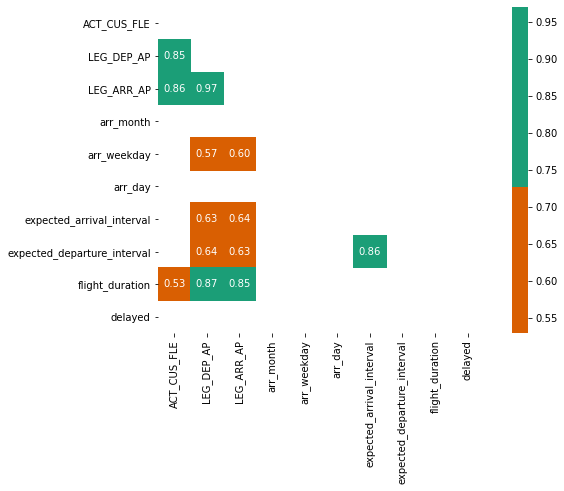

In [49]:
from phik.report import plot_correlation_matrix

phik_overview = df.phik_matrix()

matrix = phik_overview.abs()

# Create a mask
mask = np.triu(np.ones_like(matrix, dtype=bool))

# Create a custom diverging palette
cmap = sns.diverging_palette(250, 15, s=75, l=40, n=9, center="light", as_cmap=True)
plt.figure(figsize=(10,6))
sns.heatmap(matrix[matrix>0.5], mask=mask, center=0, annot=True, fmt='.2f', square=True, cmap='Dark2_r')

plt.show();

# modeling

In [50]:
df[categorical_str+categorical_int+numerical+['delayed']].head(5)

,ACT_CUS_FLE,LEG_DEP_AP,LEG_ARR_AP,arr_month,arr_weekday,arr_day,expected_arrival_interval,expected_departure_interval,flight_duration,delayed
0,FL-45X,IST,MAA,5,6,9,39,24,464.0,0
1,FL-45X,IST,MAA,5,2,12,45,30,436.0,0
2,FL-45X,IST,MAA,5,6,16,39,24,452.0,0
3,FL-45X,IST,MAA,5,2,19,45,30,447.0,0
4,FL-45X,IST,MAA,5,6,23,39,24,462.0,0


In [51]:
y = df['delayed']
X = df[categorical_str+categorical_int+numerical]

In [52]:
def create_pipeline_rf():
    numeric_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='median')),
        ('transformer', PowerTransformer(method='box-cox', standardize=False)),
        ('scaler', StandardScaler())])

    categorical_str_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='constant', fill_value='None')),
        ('one-hot', OneHotEncoder(handle_unknown='ignore'))])

    categorical_int_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='constant', fill_value=-99)),
        ('one-hot', OneHotEncoder(handle_unknown='ignore'))])

    preprocessor = ColumnTransformer(
                                    transformers=[
                                                  ('num', numeric_transformer, numerical),
                                                  ('cat_str', categorical_str_transformer, categorical_str),
                                                  ('cat_int', categorical_int_transformer, categorical_int),], 
                                    remainder='passthrough')

    pipeline = Pipeline(steps=[('preprocessor', preprocessor),
                              ('f_selector', SelectKBest(f_classif, k='all')),
                              ('classifier', RandomForestClassifier(class_weight='balanced',
                                                                    random_state=0, n_jobs=-1))])
    return pipeline

In [53]:
def evaluate_model_with_CV(X, y, model):
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=1)
    scores = cross_validate(pipeline, X, y, scoring=['accuracy', 'f1_weighted'], n_jobs=-1, 
                        return_estimator=True, return_train_score=True, cv=cv)
    # ['fit_time', 'score_time', 'estimator', 'test_accuracy', 'train_accuracy', 'test_f1_weighted', 'train_f1_weighted']
    return scores

In [54]:
def print_metrics(y_pred, y_test, model):
    print("Model results: ", type(model).__name__)
    print(classification_report(y_test, y_pred))
    print("Confusion matrix:")
    cm = confusion_matrix(y_test,y_pred, labels= model.classes_)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels= model.classes_)
    disp.plot()

### solving the data imbalance problem

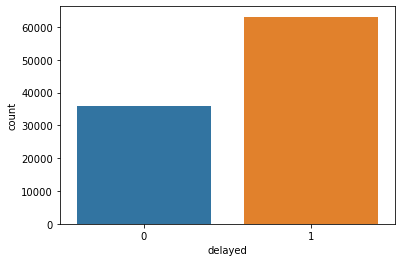

In [55]:
ax = sns.countplot(y)

Model results:  Pipeline
              precision    recall  f1-score   support

           0       0.79      0.63      0.70      9009
           1       0.81      0.90      0.85     15791

    accuracy                           0.80     24800
   macro avg       0.80      0.77      0.78     24800
weighted avg       0.80      0.80      0.80     24800

Confusion matrix:


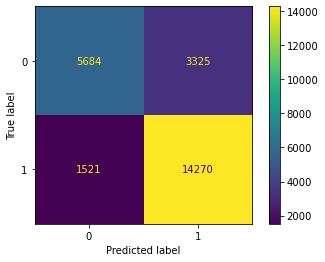

In [56]:
# base model for data
y = df['delayed']
X = df[categorical_str+categorical_int+numerical]
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.25, random_state=1)

pipe1 = create_pipeline_rf()

pipe1.fit(X_train, y_train)
preds = pipe1.predict(X_test)
print_metrics(preds, y_test, pipe1)

Model results:  Pipeline
              precision    recall  f1-score   support

           0       0.77      0.78      0.78      7207
           1       0.78      0.77      0.77      7208

    accuracy                           0.78     14415
   macro avg       0.78      0.78      0.78     14415
weighted avg       0.78      0.78      0.78     14415

Confusion matrix:


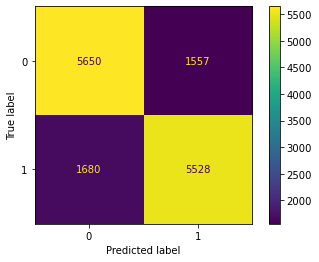

In [57]:
# balancing data with undersampling
size_for_min_label = min(df['delayed'].value_counts())
zero_label = df[df['delayed']==0].sample(size_for_min_label)
one_label = df[df['delayed']==1].sample(size_for_min_label)

df_v2 = pd.concat([zero_label, one_label])

y = df_v2['delayed']
X = df_v2[categorical_str+categorical_int+numerical]
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, random_state=1)

pipe2 = create_pipeline_rf()

pipe2.fit(X_train, y_train)
preds = pipe2.predict(X_test)
print_metrics(preds, y_test, pipe2)

we can say that undersampling the majority class helped to solve imbalance problem. We have enough data, so, no need to generate synthetic data.

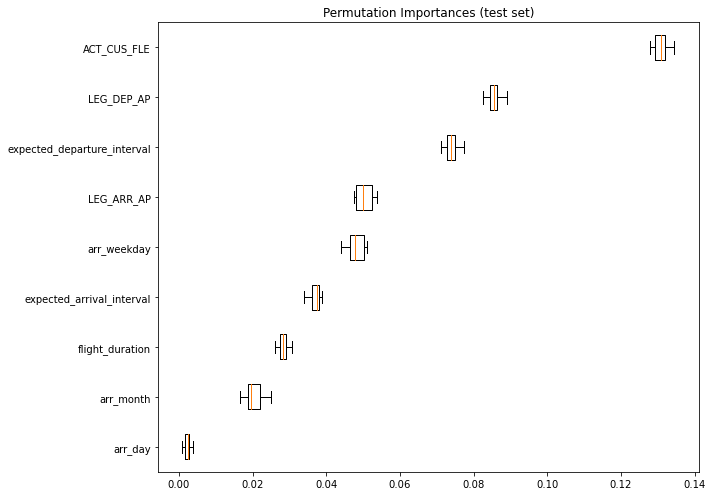

In [58]:
# lets look at the feature importances
from sklearn.inspection import permutation_importance

result = permutation_importance(pipe2, X_test, y_test, n_repeats=10,
                                random_state=42, n_jobs=2)
sorted_idx = result.importances_mean.argsort()

fig, ax = plt.subplots(figsize=(10,7))
ax.boxplot(result.importances[sorted_idx].T,
           vert=False, labels=X_test.columns[sorted_idx])
ax.set_title("Permutation Importances (test set)")
fig.tight_layout()
plt.show()

by undersampling we solve the imbalanced data problem and now time for best model and tuning

## Auto ML

In [59]:
import xgboost
import lightgbm
import sklearn
import time
from tqdm import tqdm
from sklearn.base import ClassifierMixin
from sklearn.utils.testing import all_estimators
from sklearn.metrics import average_precision_score, accuracy_score, balanced_accuracy_score, recall_score, precision_score, f1_score

In [60]:
def create_pipeline_without_clf(clf_name, clf_object):
    
    numeric_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='median')),
        ('transformer', PowerTransformer(method='box-cox', standardize=False)),
        ('scaler', StandardScaler())])

    categorical_str_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='constant', fill_value='None')),
        ('one-hot', OneHotEncoder(handle_unknown='ignore'))])

    categorical_int_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='constant', fill_value=-99)),
        ('one-hot', OneHotEncoder(handle_unknown='ignore'))])

    preprocessor = ColumnTransformer(
                                    transformers=[
                                                  ('num', numeric_transformer, numerical),
                                                  ('cat_str', categorical_str_transformer, categorical_str),
                                                  ('cat_int', categorical_int_transformer, categorical_int),], 
                                    n_jobs = -1,
                                    transformer_weights = None,
                                    remainder='passthrough')
    
    pipeline = Pipeline(steps=[('preprocessor', preprocessor),
                          ('f_selector', SelectKBest(f_classif, k='all')),
                          (clf_name, clf_object)], verbose=False)
        
    return pipeline

In [61]:
CLASSIFIERS = [est for est in all_estimators() if issubclass(est[1], ClassifierMixin)]
removed_classifiers = [
    ("CheckingClassifier", sklearn.utils._mocking.CheckingClassifier),
    ("ClassifierChain", sklearn.multioutput.ClassifierChain),
    ("ComplementNB", sklearn.naive_bayes.ComplementNB),
    ("GradientBoostingClassifier", sklearn.ensemble.gradient_boosting.GradientBoostingClassifier,),
    ("GaussianProcessClassifier", sklearn.gaussian_process.gpc.GaussianProcessClassifier,),
    ("HistGradientBoostingClassifier", sklearn.ensemble._hist_gradient_boosting.gradient_boosting.HistGradientBoostingClassifier,),
    ("MLPClassifier", sklearn.neural_network.multilayer_perceptron.MLPClassifier),
    ("LogisticRegressionCV", sklearn.linear_model.logistic.LogisticRegressionCV),
    ("MultiOutputClassifier", sklearn.multioutput.MultiOutputClassifier),
    ("MultinomialNB", sklearn.naive_bayes.MultinomialNB),
    ("OneVsOneClassifier", sklearn.multiclass.OneVsOneClassifier),
    ("OneVsRestClassifier", sklearn.multiclass.OneVsRestClassifier),
    ("OutputCodeClassifier", sklearn.multiclass.OutputCodeClassifier),
    ("RadiusNeighborsClassifier", sklearn.neighbors.classification.RadiusNeighborsClassifier,),
    ("VotingClassifier", sklearn.ensemble.voting.VotingClassifier),
]

for i in removed_classifiers:
    CLASSIFIERS.pop(CLASSIFIERS.index(i))
    
CLASSIFIERS.append(("XGBClassifier", xgboost.XGBClassifier))
CLASSIFIERS.append(("LGBMClassifier", lightgbm.LGBMClassifier))

In [62]:
random_state = 10
Accuracy_mean = []
Accuracy_std = []
F1_mean = []
F1_std = []
names = []
TIME = []
predictions = {}
models = {}

for name, model in tqdm(CLASSIFIERS):
    start = time.time()
    try:
        if "random_state" in model().get_params().keys():
            if "class_weight" in model().get_params().keys():
                pipeline = create_pipeline_without_clf("classifier", model(random_state=random_state, class_weight='balanced'))
            else:
                pipeline = create_pipeline_without_clf("classifier", model(random_state=random_state))
        else:
            if "class_weight" in model().get_params().keys():
                pipeline = create_pipeline_without_clf("classifier", model(class_weight='balanced'))
            else:
                pipeline = create_pipeline_without_clf("classifier", model())
                
                                   
        results = evaluate_model_with_CV(X, y, model)
                        
        names.append(name)
        Accuracy_mean.append(results['test_accuracy'].mean())
        Accuracy_std.append(results['test_accuracy'].std())
        F1_mean.append(results['test_f1_weighted'].mean())
        F1_std.append(results['test_f1_weighted'].std())
        TIME.append(results['fit_time'].mean())
    
    except Exception as exception:
        print(name + " model failed to execute")
        print(exception)
                                   
scores = pd.DataFrame(
    {   "Model": names,
        "Accuracy Mean": Accuracy_mean,
        "Accuracy Std": Accuracy_std,
        "F1-Score Mean": F1_mean,
        "F1-Score Std": F1_std,
        "Time Taken": TIME, })      

 59%|███████████████████████████████████████████████▍                                 | 17/29 [32:35<23:00, 115.01s/it]


KeyboardInterrupt: 

In [ ]:
scores.sort_values(by='F1-Score Mean', ascending=False)

In [ ]:
final_models = scores[(scores['F1-Score Mean']>0.75) & (scores['Time Taken']<500.0)].nlargest(3, 'F1-Score Mean')
final_models

In [ ]:
final_models.Model.values

In [ ]:
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier

In [ ]:
classifier_objects = {
    'RandomForestClassifier' : RandomForestClassifier(random_state=0, n_jobs=-1),
    'ExtraTreesClassifier' : ExtraTreesClassifier(random_state=0, n_jobs=-1),
    'KNeighborsClassifier' : KNeighborsClassifier()
}

In [ ]:
params_list = {
'RandomForestClassifier' : {'max_depth': [5,10, 20, None], 'min_samples_leaf': [1, 2, 3, 5,10], 
                            'min_samples_split': [2, 3, 5], 'n_estimators': [100, 250, 500]},
    
'ExtraTreesClassifier' : {'min_samples_leaf': [1, 2, 3, 5,10],
                          'max_depth': [None, 5,10, 20], 'min_samples_split': [2,3,5],
                          'n_estimators': [100, 250,500]},
'KNeighborsClassifier' : {'weights': ['uniform', 'distance'], 'n_neighbors':[1,3,5,7,9,11,13,15]}
}

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.20, random_state=42)

In [ ]:
def prepare_param_grid(params):
    
    param_grid = {}
    for key, value in params.items():
        new_key = 'classifier__' + key 
        param_grid[new_key] = value
    return param_grid

In [ ]:
def grid_search(classifier, clf):
    
    param_grid = prepare_param_grid(params_list[clf])
    grid_search = GridSearchCV(classifier, param_grid=param_grid, cv = 5, scoring='f1_weighted', verbose = -1,  n_jobs = 16)
    grid_search.fit(X_train, y_train)
    gs_preds = grid_search.predict(X_test)
    
    return gs_preds, grid_search.best_params_, grid_search.cv_results_['mean_test_score']

In [ ]:
k=0
gs_results = pd.DataFrame(columns=['Model', 'acc_score', 'best_params', 'F1-score', 'mean val score', 'clf_report'])

for model in final_models.Model.values:
    
    k+=1
    #try:
    pipeline = create_pipeline_without_clf("classifier", classifier_objects[model])
    preds, best_params, mean_val_score = grid_search(pipeline, model)
    #except:
    #    print('an error with', model)
    #    continue
    f1_s = f1_score(y_test, preds, average='weighted')
    acc_score = accuracy_score(y_test, preds)
    clf_report = classification_report(y_test, preds)
    
    gs_results = gs_results.append(pd.DataFrame({'Model':model,'acc_score':[acc_score], 'best_params':str(best_params),
                                           'F1-score':f1_s, 'mean val score':[mean_val_score],'clf_report':clf_report}, index=[k]))

In [ ]:
gs_results

In [ ]:
gs_results.loc[3, 'best_params']

## voting classifier

In [ ]:
gs_results['Model']

In [ ]:
from sklearn.ensemble import VotingClassifier

clf1 = create_pipeline_without_clf('etc',ExtraTreesClassifier(max_depth= None, min_samples_leaf= 1, min_samples_split= 3, n_estimators= 500))
clf2 = create_pipeline_without_clf('rfc',RandomForestClassifier(max_depth= None, min_samples_leaf= 1, min_samples_split= 2, n_estimators= 500))
clf3 = create_pipeline_without_clf('knn', KNeighborsClassifier(n_neighbors= 5, weights= 'distance'))


    
eclf = VotingClassifier(
    estimators=[('etc', clf1), ('rf', clf2), ('knn', clf3)],
    voting='hard')
    
eclf1 = VotingClassifier(
    estimators=[('etc', clf1), ('rf', clf2), ('knn', clf3)],
    voting='soft', weights=[1,1,2])

eclf2 = VotingClassifier(
    estimators=[('etc', clf1), ('rf', clf2), ('knn', clf3)],
    voting='soft', weights=[2,2,1])

for clf, label in zip([clf1, clf2, clf3, eclf, eclf1, eclf2], ['ExtraTree', 'Random Forest', 'K-NN', 'Voting1', 'Voting2', 'Voting3']):
    scores = cross_val_score(clf, X, y, scoring='f1_weighted', cv=5, n_jobs=-1)
    print(label, ' - ', scores.mean(), '+-',scores.std())


## stacking classifier

In [ ]:
from sklearn.ensemble import StackingClassifier

clf1 = create_pipeline_without_clf('etc',(max_depth= None, min_samples_leaf= 1, min_samples_split= 3, n_estimators= 500))
clf2 = create_pipeline_without_clf('rfc',RandomForestClassifier(max_depth= None, min_samples_leaf= 1, min_samples_split= 2, n_estimators= 500))
clf3 = create_pipeline_without_clf('knn', KNeighborsClassifier(n_neighbors= 5, weights= 'distance'))


estimators_list = [('etc', clf1),('rfc', clf2),('knn', clf3)]
stacking = StackingClassifier(estimators=estimators_list,  n_jobs=-1)

X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.20, random_state=42)

stacking.fit(X_train, y_train)
preds = stacking.predict(X_test)
print_metrics(preds, y_test, stacking)
print(f1_score(preds, y_test, average='weighted'))

## validation data

#### no need to run, only for validation data

In [ ]:
test = pd.read_csv('CARGO_FOTP_VAL.csv')

In [ ]:
test['LEG_DEP_GMT_DT'] = test['LEG_DEP_GMT_DT'].apply(convert_date)
test['LEG_ARR_GMT_DT'] = test['LEG_ARR_GMT_DT'].apply(convert_date)
test['flight_duration_day'] = (pd.to_datetime(test['LEG_ARR_GMT_DT']) - pd.to_datetime(test['LEG_DEP_GMT_DT'])).apply(lambda x: x.days)
test['flight_duration_min'] = test[['LEG_ARR_GMT_TM', 'LEG_DEP_GMT_TM']].apply(lambda x: find_hour_difference(*x), axis=1)
test['flight_duration'] = test['flight_duration_min'] + test['flight_duration_day']*1440
test['arr_month'] = pd.to_datetime(test['LEG_ARR_GMT_DT']).dt.month
test['arr_weekday'] = pd.to_datetime(test['LEG_ARR_GMT_DT']).dt.weekday
test['arr_day'] = pd.to_datetime(test['LEG_ARR_GMT_DT']).dt.day
test['expected_arrival_interval'] = test['LEG_ARR_GMT_TM'].apply(convert_hours).apply(convert_time_to_interval)
test['expected_departure_interval'] = test['LEG_DEP_GMT_TM'].apply(convert_hours).apply(convert_time_to_interval)

In [ ]:
X_test = test[categorical_str+categorical_int+numerical]

In [ ]:
clf1 = create_pipeline_without_clf('etc',ExtraTreesClassifier(max_depth= None, min_samples_leaf= 1, min_samples_split= 3, n_estimators= 500))
clf2 = create_pipeline_without_clf('rfc',RandomForestClassifier(max_depth= None, min_samples_leaf= 1, min_samples_split= 2, n_estimators= 500))
clf3 = create_pipeline_without_clf('knn', KNeighborsClassifier(n_neighbors= 5, weights= 'distance'))


estimators_list = [('etc', clf1),('rfc', clf2),('knn', clf3)]
stacking = StackingClassifier(estimators=estimators_list,  n_jobs=-1)

X_train, y_train = X, y

stacking.fit(X_train, y_train)
preds = stacking.predict(X_test)

In [ ]:
X_test

In [ ]:
result = pd.read_csv('CARGO_FOTP_VAL.csv')

In [ ]:
preds.shape

In [ ]:
result['DELAY_FLAG'] = preds

In [ ]:
result.to_csv('CARGO_FOTP_DATA_BUTCHERS.csv')

In [ ]:
result['DELAY_FLAG']

In [ ]:
only_result = pd.DataFrame(preds, index=X_test.index, columns=['DELAY_FLAG'])
only_result

In [ ]:
only_result.to_csv('only_result.csv')